In [1]:
using InteractiveUtils
versioninfo()

Julia Version 1.4.2
Commit 44fa15b150* (2020-05-23 18:35 UTC)
Platform Info:
  OS: macOS (x86_64-apple-darwin18.7.0)
  CPU: Intel(R) Core(TM) i5-3210M CPU @ 2.50GHz
  WORD_SIZE: 64
  LIBM: libopenlibm
  LLVM: libLLVM-8.0.1 (ORCJIT, ivybridge)


In [2]:
module ParticleFilter

using LinearAlgebra
using Distributions
using Rotations

using Plots
gr()

Q = diagm([0.2]) ^ 2
R = diagm([2.0, deg2rad(40.0)]) ^ 2

Q_sim = diagm([0.2]) ^ 2
R_sim = diagm([1.0, deg2rad(30.0)]) ^ 2

DT = 0.1
SIM_TIME = 50.0
MAX_RANGE = 20.0

NP = 100
NTh = NP / 2.0

show_animation = true

function localize()
    println("start!")
    
    time = 0.0
    
    # RF_ID positions [x,y]
    rf_id = [10.0 0.0; 10.0 10.0; 0.0 15.0; -5.0 20.0]
    
    # State Vector [x,y,yaw,v]'
    x_est = zeros(4, 1)
    x_true = zeros(4, 1)
    
    px = zeros(4, NP) # Particle store
    pw = zeros(1, NP) .+ 1.0 / NP # Particle weight
    x_dr = zeros(4, 1) # Dead reckoning
    
    # history
    h_x_est = x_est
    h_x_true = x_true
    h_x_dr = x_true
    
    while SIM_TIME >= time
        time += DT
        # calculate input [v, yawrate]
        u = calc_input()
        
        # observation
        x_true, z, x_dr, ud = observation(x_true, x_dr, u, rf_id)
        
        # particle filter localization
        x_est, PEst, px, pw = pf_localization(px, pw, z, ud)
        
        # save
        h_x_est = hcat(h_x_est, x_est)
        h_x_dr = hcat(h_x_dr, x_dr)
        h_x_true = hcat(h_x_true, x_true)
        
        if show_animation
            plot(reuse = false)
            for i in 1:length(z[:,1])
                plot!([x_true[1,1], z[i, 2]], [x_true[2,1], z[i,3]], linestyle=:dash, linecolor="black")
            end
            plot!(rf_id[:,1], rf_id[:,2], st=:scatter)
            plot!(px[1,:], px[2,:], linestyle=:dot, linecolor="red")
            plot!(h_x_true[1, :], h_x_true[2, :], linestyle=:dash, linecolor="blue")
            plot!(h_x_dr[1, :], h_x_dr[2, :], linestyle=:dash, linecolor="black")
            plot!(h_x_est[1, :], h_x_est[2, :], linestyle=:dash, linecolor="red")
            plot_covariance_ellips(x_est, PEst)
        end
    end
    
    return h_x_est, h_x_dr, h_x_true
end

function calc_input()
    v = 1.0
    yaw_rate = 0.1
    u = [v; yaw_rate]
    return u 
end

function observation(x_true, xd, u, rf_id)
    # calculate true X
    x_true = motion_model(x_true, u)
    
    z = zeros(1,3)
    
    # calculate distance for each RF_ID
    for i in 1:length(rf_id[:, 1])
        dx = x_true[1, 1] - rf_id[i, 1]
        dy = x_true[2, 1] - rf_id[i, 2]
        d = hypot(dx, dy)
        
        # if in observation range
        if d <= MAX_RANGE
            # add noise to gps x-y
            dn = d + randn() * Q_sim[1, 1] ^ 0.5
            zi = [dn rf_id[i, 1] rf_id[i, 2]]
            z = vcat(z, zi)
        end
    end
    z = z[2:end, :]
    
    # add noise to input
    ud1 = u[1, 1] + randn() * R_sim[1, 1] ^ 0.5
    ud2 = u[2, 1] + randn() * R_sim[2, 2] ^ 0.5
    ud = [ud1; ud2]
    
    # calcurate X by Dead reckoning
    xd = motion_model(xd, ud)
    
    return x_true, z, xd, ud
end

function motion_model(x, u)
    F = [1.0 0.0 0.0 0.0;
        0.0 1.0 0.0 0.0;
        0.0 0.0 1.0 0.0;
        0.0 0.0 0.0 0.0]
    
    B = [DT * cos(x[3,1]) 0.0;
        DT * sin(x[3,1]) 0.0;
        0.0 DT;
        1.0 0.0]

    x = F * x + B * u
    
    return x
end

function pf_localization(px, pw, z, u)
    # for each particle
    for ip in 1:NP
        x = px[:, ip] # select a particle
        w = pw[1, ip] # select a weight
        
        ud1 = u[1, 1] + randn() * R[1, 1] ^ 0.5
        ud2 = u[2, 1] + randn() * R[2, 2] ^ 0.5
        ud = [ud1; ud2]
        x = motion_model(x, ud)
        
        for i in 1:length(z[:, 1])
            dx = x[1, 1] - z[i, 2]
            dy = x[2, 1] - z[i, 3]
            pre_z = hypot(dx, dy)
            dz = pre_z - z[i, 1]
            w = w * gauss_likehood(dz, sqrt(Q[1, 1]))
        end
        
        px[:, ip] = x[:, 1]
        pw[1, ip] = w
        
    end
    
    pw = pw / sum(pw)
    x_est = px * pw'
    p_est = calc_covariance(x_est, px, pw)
    
    N_eff = 1.0 / (dot(pw, pw'))[1, 1]
    
    if N_eff < NTh
        px, pw = re_sampleing(px, pw) 
    end
    
    return x_est, p_est, px, pw
    
end

function gauss_likehood(x, sigma)
    p = 1.0 / sqrt(2.0 * pi * sigma ^ 2) * exp(-x ^ 2 / (2 * sigma ^ 2))
    
    return p 
end

function calc_covariance(x_est, px, pw)
    cov = zeros(3,3)
    n_particle = size(px)[2]
    for i in 1:n_particle
        dx = (px[:, i] - x_est)[1:3]
        cov += pw[1, i] * dx * dx'
    end
    cov *= 1.0 / (1.0 - (pw * pw')[1])
    
    return cov
end

function re_sampleing(px, pw)
    w_cum = cumsum(pw, dims=2)
    base = 0:1/NP:1.0
    re_sample_id = base .+ rand(Uniform(0, 1/NP))
    indexes = []
    ind = 1
    
    for ip in 1:NP
        while re_sample_id[ip] > w_cum[ind]
            ind += 1
        end
        append!(indexes, ind)
    end
    
    px =px[:, indexes]
    pw = zeros(1, NP) .+ 1.0 / NP
    
    return px, pw
    
end

function plot_covariance_ellips(x_est, p_est)
    p_xy = p_est[1:3, 1:3]
    eig_val = eigvals(p_xy)
    eig_vec = eigvecs(p_xy)
    
    if eig_val[1] >= eig_val[2]
        big_ind = 0
        small_ind = 1
    else
        big_ind =1 
        small_ind = 0
    end
    
    t = 0:0.1:2*pi+0.1
    
    a, b = 0.0, 0.0
    
    try
        a = sqrt(eig_val[big_ind])
    catch
        a = 0.0
    end
    
    try
        b = sqrt(eig_val[small_ind])
    catch
        b = 0.0
    end
    
    x = [a * cos(it) for it in t]
    y = [b * sin(it) for it in t]
    angle = atan(eig_vec[2, big_ind], eig_vec[1, big_ind])
    rot = RotZ(1)[1:2, 1:2]
    fx = rot * [x,y]
    px = fx[1] .+ x_est[1, 1]
    py = fx[2] .+ x_est[2, 1]
    display(plot!(px, py, linestyle=:dash, color="red"))
end

end

Main.ParticleFilter

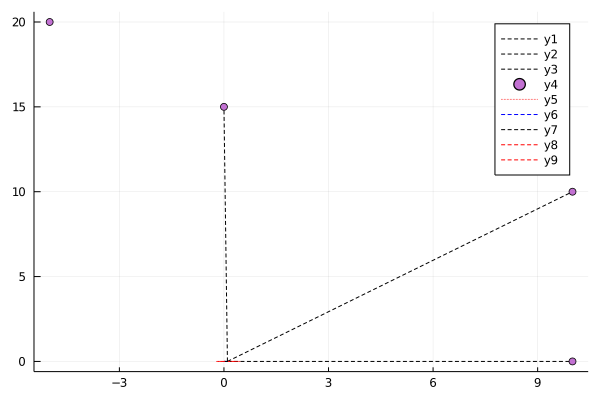

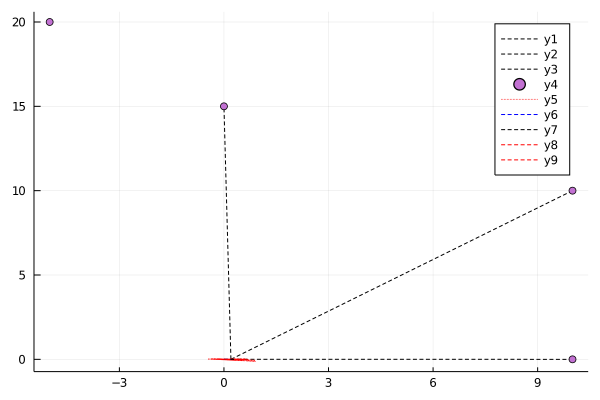

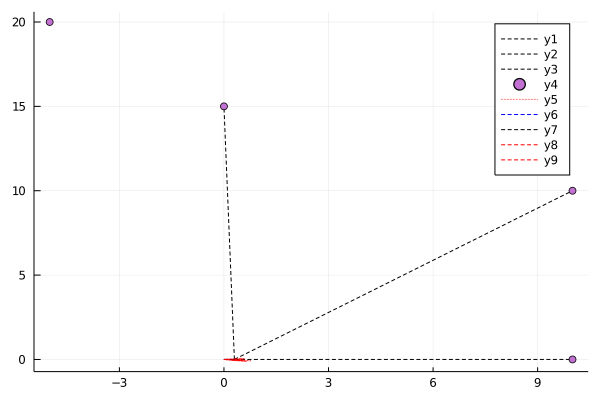

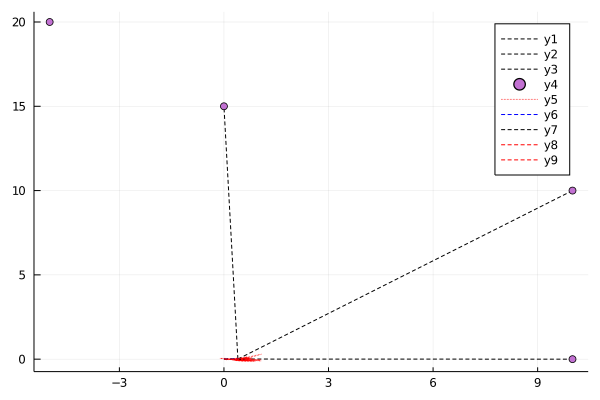

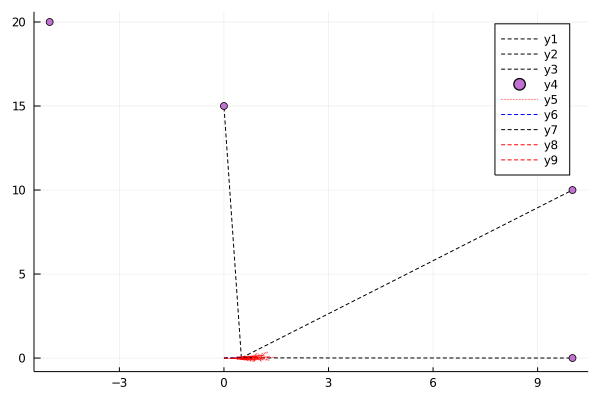

...

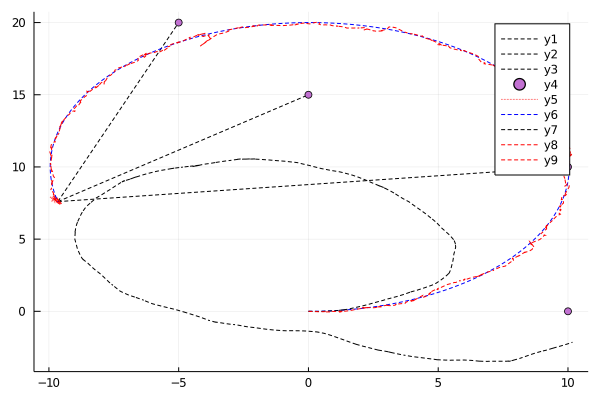

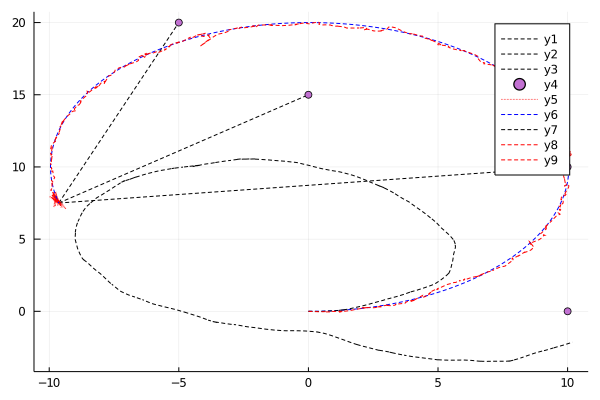

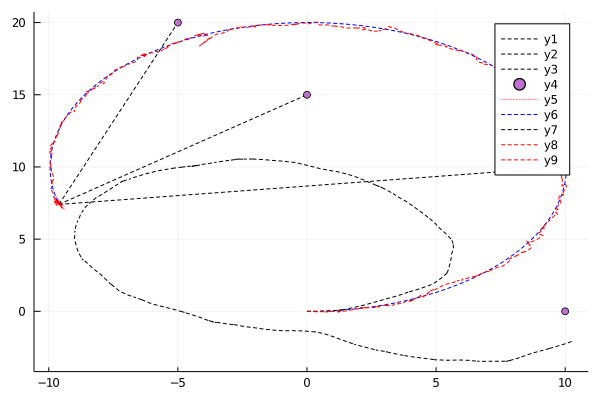

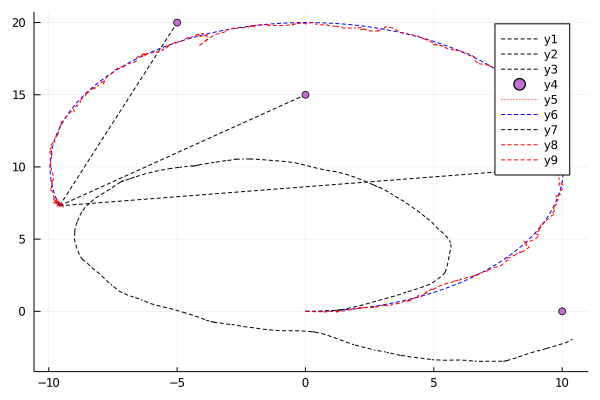

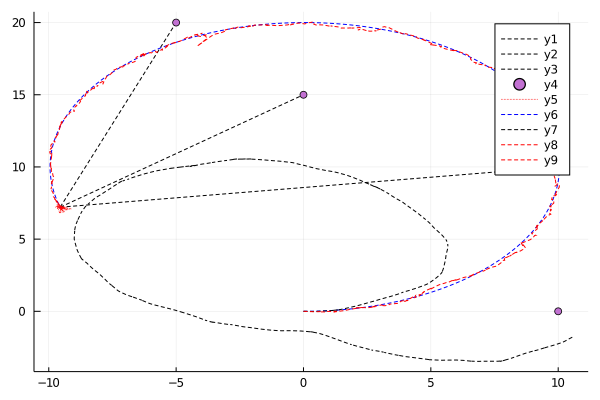

start!


([0.0 0.028663694359736567 … -9.67398831097494 -9.482766861344922; 0.0 0.0 … 7.5231479190812385 7.09933479815244; 0.0 -0.08579065669123133 … 5.1011157421692 5.08263405396837; 0.0 0.2866369435973656 … 0.40781545144955517 3.5090442570120466], [0.0 0.2086471403039486 … 10.401626446067437 10.561856332697062; 0.0 0.0 … -1.9321810129432526 -1.7844820715106258; 0.0 -0.07073302822286155 … 7.027911621327468 7.029111306435989; 0.0 2.0864714030394858 … 1.670390603788444 2.1791877814832885], [0.0 0.1 … -9.580751837370258 -9.553345945415721; 0.0 0.0 … 7.307435954526645 7.211264664183964; 0.0 0.010000000000000002 … 4.989999999999938 4.999999999999938; 0.0 1.0 … 1.0 1.0])

In [3]:
h_x_est, h_x_dr, h_x_true = ParticleFilter.localize()

In [4]:
using Plots
gr()

Plots.GRBackend()

In [5]:
using LinearAlgebra

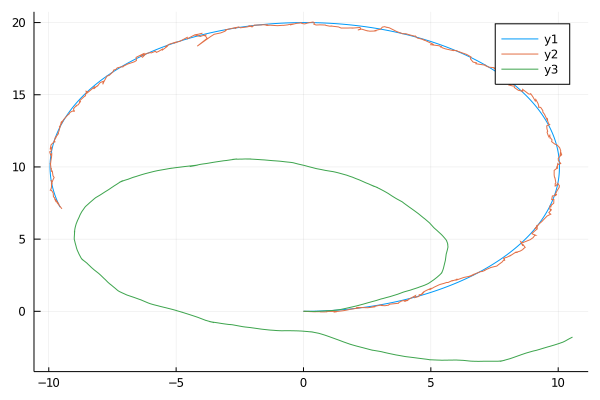

In [6]:
plot(h_x_true[1, :], h_x_true[2, :])
plot!(h_x_est[1, :], h_x_est[2, :])
plot!(h_x_dr[1, :], h_x_dr[2, :])